In [1]:
%load_ext autoreload
%autoreload 2

import pandas as pd
import numpy as np
import squidpy as sq
from skimage import io
import scanpy as sc
import time
import os
from dotenv import load_dotenv

napari.manifest -> 'napari-spongepy' could not be imported: Cannot find module 'napari_spongepy' declared in entrypoint: 'napari_spongepy:napari.yaml'


In [2]:
from napari_sparrow import functions as fc

# Read in the RESOLVE data 
The first step of the analysis includes defining the paths to both the DAPI stained image and the list of the coordinates for each transcript. 
When working with both nucleus and cell wall images, both paths are needed, but this is shown in a different notebook 
[[TODO]]: link notebook 

The image is expected to be a tiff file, the trancripts location a txt file. If the image is in zarr, a different read in function can be used: 
[[TODO]]: mention read in function 

When working with both nucleus and cellwall images, both paths need to be defined here.  

Currently, squidpy imagecontainers are used to handle the images, while performing the image-processing steps. Once this is possible in spatialdata, this will be adapted. 

In [3]:
from dask.distributed import Client
client = Client(n_workers=1, threads_per_worker=1, memory_limit='200GB',local_directory='/srv/scratch',dashboard_address=42738)
client

In [4]:
# Path prefix for the data folder, use variable from .env file or default
DATA_PATH_PREFIX = os.getenv("DATA_PATH_PREFIX", default="../data")
DATA_PATH_PREFIX='/srv/scratch/data/spatial' #to be adapted
SMALL_IMAGE = os.getenv("SMALL_IMAGE", default="False") in ["True", "true", "t"]
DEVICE = os.getenv("DEVICE", default="cpu")

OUTPUT_DIR='/srv/scratch/lottep/notebook_runs/benchmark_liver_resolve_arne'

name_slide = "A1-1"
path_coordinates = DATA_PATH_PREFIX + "/resolve_liver/20272_slide1_" + name_slide + "_results.txt"
path_image = DATA_PATH_PREFIX + "/resolve_liver/20272_slide1_" + name_slide + "_DAPI.tiff"

crop_segment=False # set to True to run segmentation step on a crop
crop_param=[ 5000, 3000, 4000 ] #x,y,size

#### Convert to zarr and load the image. 

In order to make the pipeline scalable, we save all data in zarr format. 
The main advantage here is that the data is saved in chunks, and we can load it in chunk by chunk, menaing the whole dataset is never to be completely loaded into memory. 

In [5]:
import os
from pathlib import Path

if os.path.splitext( path_image )[ -1 ] != '.zarr':

    fc.write_to_zarr( Path( path_image), output_name='raw_image' )

zarr_path= os.path.join( os.path.dirname( path_image ) , 'raw_image.zarr', 'scale0' )

ic=fc.read_in_zarr_from_path( zarr_path, 'raw_image'  )

/srv/scratch/lottep/tryout_spongepy/napari-spongepy/src/napari_sparrow/functions.py:2110: RuntimeWarning: Failed to open Zarr store with consolidated metadata, falling back to try reading non-consolidated metadata. This is typically much slower for opening a dataset. To silence this warning, consider:
1. Consolidating metadata in this existing store with zarr.consolidate_metadata().
2. Explicitly setting consolidated=False, to avoid trying to read consolidate metadata, or
3. Explicitly setting consolidated=True, to raise an error in this case instead of falling back to try reading non-consolidated metadata.
  xarray_ds=xr.open_zarr( path )


A small part of the image cna be plotted useing following function:
It is clear here we need some correction to remove artefacts

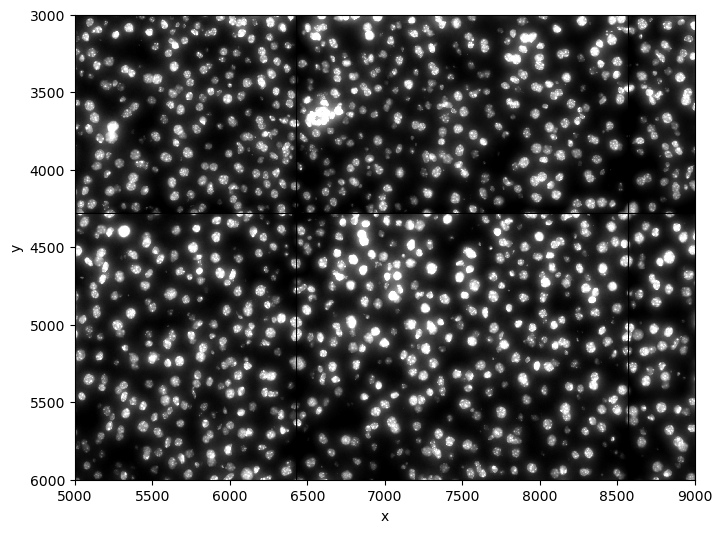

In [6]:
crd=[ 5000, 9000, 3000, 6000 ] # crd used for visualization purposes

fc.plot_image_container( ic, layer='raw_image', crd=crd, figsize=( 8,8 ) )

# Processing the image(s)

When working with RESOLVE data, the data is acquired in tiles, and the illumination within a tile isn't constant, because of technical issues. Sometimes one side of a tile is more illuminated than the other, influencing the downstream analysis greatly.

Basic is a tool that can correct for this, and is used in this function. More information can be found here: https://www.nature.com/articles/ncomms14836

in the function tilingCorrection, the tilesize can be adapted with the parametere tile_size. It is set to 2144, the standard tile size in pixels for RESOLVE data. 

 RESOLVE has missing data on the borders of two tiles, resulting in black lines on the border between tiles. This can split up cells, and thus influence the analysis. Inpainting this black line circumvents this, and is alos done in this process.


INFO:basicpy.basicpy:Initializing BaSiC 140602869080720 with parameters: 
smoothness_flatfield: 1

INFO:basicpy.basicpy:=== BaSiC fit started ===
INFO:basicpy.basicpy:reweighting iteration 0
INFO:basicpy.basicpy:single-step optimization score: 7.006038913459633e-07.
INFO:basicpy.basicpy:mean of S: 1.0.
INFO:basicpy.basicpy:Iteration 0 finished.
INFO:basicpy.basicpy:reweighting iteration 1
INFO:basicpy.basicpy:single-step optimization score: 8.519558036823582e-07.
INFO:basicpy.basicpy:mean of S: 1.0000001192092896.
INFO:basicpy.basicpy:Iteration 1 finished.
INFO:basicpy.basicpy:reweighting score: 0.00963823776692152
INFO:basicpy.basicpy:elapsed time: 5.213396333158016 seconds
INFO:basicpy.basicpy:Reweighting converged.
INFO:basicpy.basicpy:=== BaSiC fit finished in 6.219297327101231 seconds ===
INFO:basicpy.basicpy:=== BaSiC transform started ===
INFO:basicpy.basicpy:=== BaSiC transform finished in 1.8157958537340164 seconds ===


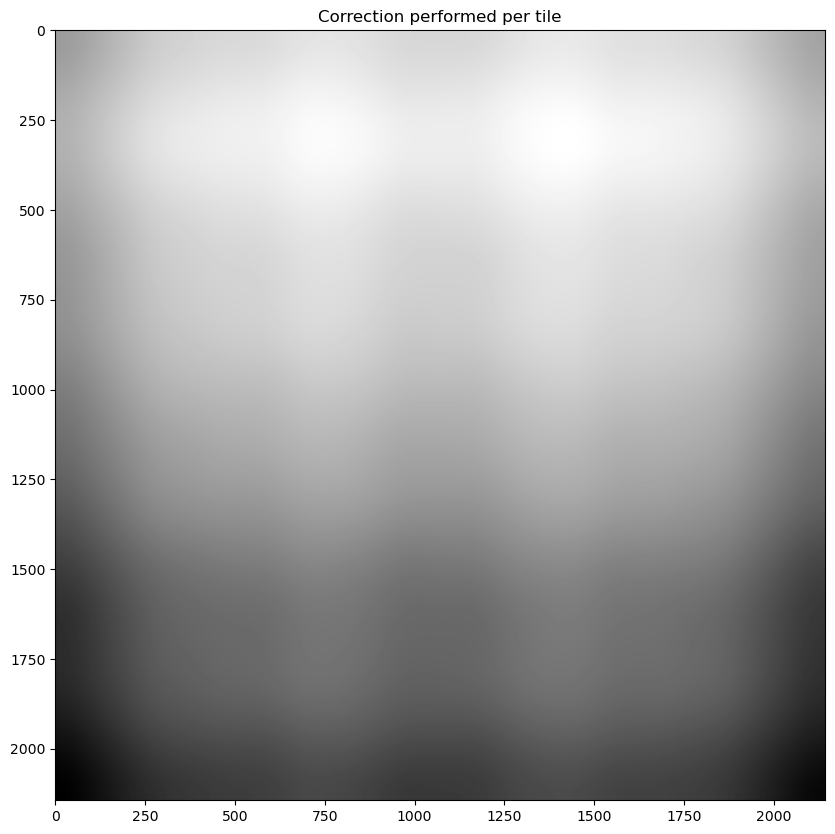

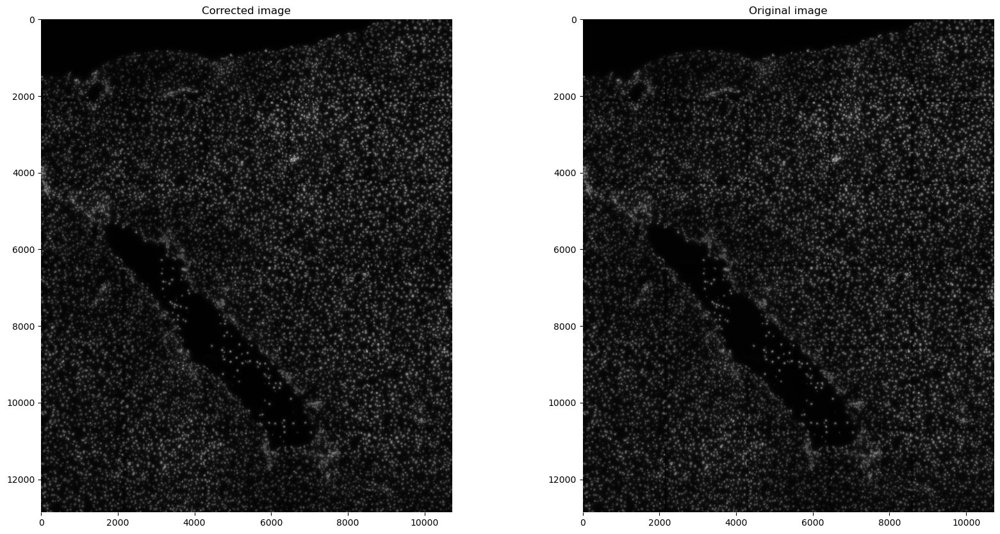

In [7]:
ic, flatfield = fc.tilingCorrection(
    ic=ic, 
    left_corner=[0, 0] if SMALL_IMAGE else None, 
    size=[4288, 4288] if SMALL_IMAGE else None
    )
fc.tilingCorrectionPlot( 
    img=ic.data.corrected.squeeze().to_numpy(),
    flatfield= flatfield, 
    img_orig= ic.data.raw_image.squeeze().to_numpy() , 
    )

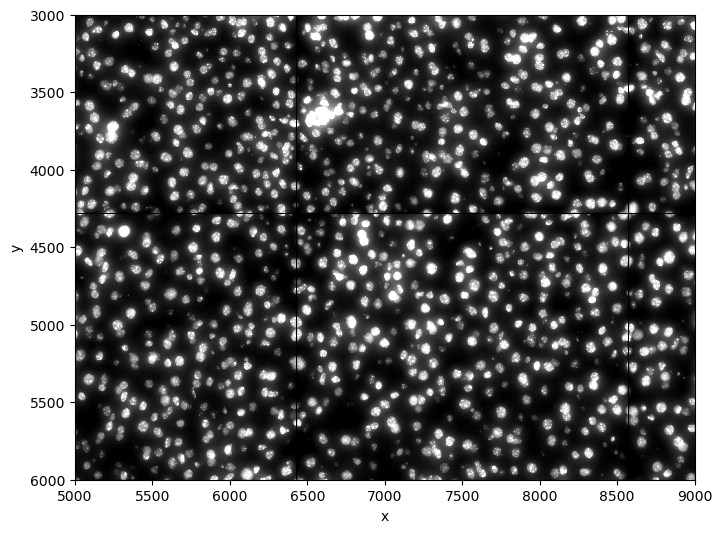

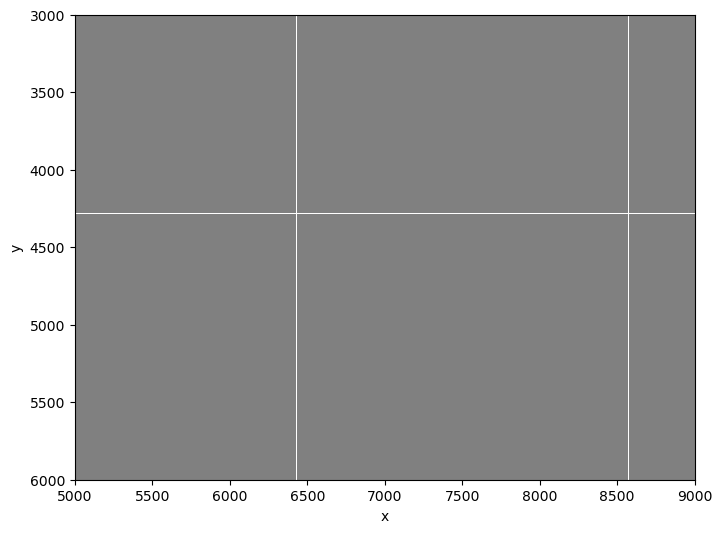

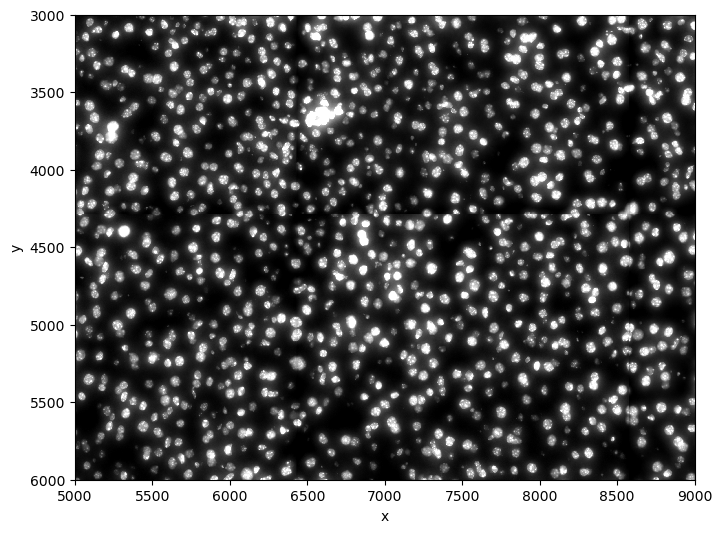

In [8]:
fc.plot_image_container( ic, layer='raw_image', crd=crd, figsize=( 8,8 ) )
fc.plot_image_container( ic, layer='mask_black_lines', crd=crd, figsize=( 8,8 ) )
fc.plot_image_container( ic, layer='corrected', crd=crd, figsize=( 8,8 ) )

The second step of the preprocessing the data includes two extra steps:

 A top-hat filter can be added to substract background noise and to make the cells/nuclei borders cleaner, as well as to delete occasional debris. The filter is added by defining its size.
 
    - If too small (smaller than the nuclei), the function will create donuts, with black spots in the center of the cells.
    - If too big, not enough background will be substracted.
    - A trade-off should be made, which might need some fine-tuning. More information can be found [here (❗ broken link)](https://biapol.github.io/blog/ryan_savill/03_background_subtraction/).
    - As a starting point, 45-55 is a great for nuclei, and bigger for whole cells (around 100-200)
    
This function enhances the contrast (i.e. white and black are more distinct) by using histogram equalization (CLAHE function). The amount of correction needed can be decided by adapting the contrast_clip value (~3.5 for bright images, and ~10 for dark images, but in some cases, much bigger values give even better results).

    - If you still see parts of the image that are lighter/darker than other parts, enhance this parameter. 
    - If you have the feeling background noise is now so bright is is seen as cells, make the contrast less.


The result of this function is a cleaned up images, that will give rise to better segmentation results. 

As we want to run this analysis without overflowing our memory, we write out the outcome to an output file in OUTPUT_DIR. This makes it easier to restart analysis too! 


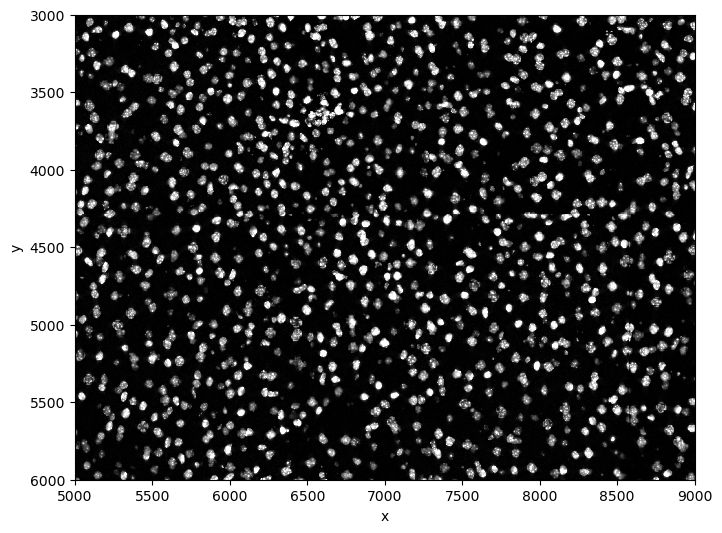

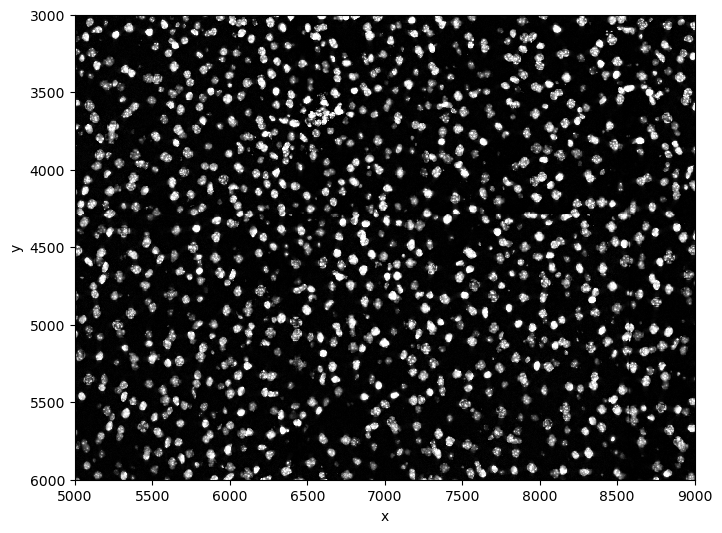

In [9]:
ic=fc.tophat_filtering( img=ic, output_dir=OUTPUT_DIR, layer='corrected', size_tophat= 45 )
fc.plot_image_container( ic, layer='corrected', crd=crd, figsize=( 8,8 ) )
ic=fc.clahe_processing( img=ic, output_dir=OUTPUT_DIR, layer='corrected', contrast_clip=3.5, chunksize_clahe=20000 )
fc.plot_image_container( ic, layer='corrected', crd=crd, figsize=( 8,8 ) )

# Segmenting the image

For the segmentation, we make use of Cellpose, a deep learning network based on a UNET architecture. This is a great tool , because it segments both nuclei and whole cells. 
Multiple paramters need to be given as an inpute to the cellpose algorithm. 
- diameter: Includes an estimate of the diameter of a nucleus. If put to none, cellpose will do the estimation by himself, but this estimation might take longer than the actual segmentation. You can run the algorthim on a small piece (I[0:1000,0:1000] for example), to get an estimate. However, this estimate isn't always accurate. So check the quality at the end. If you see all nuclei/cells are estimated too small, enlarge this parameter.
- device: Defines the device you want to work on, if you only have cpu, you can skip this input parameter. If only having CPU, please tune the parameters on a small subset, and then make it to the big one. This might take a while. If that doesn't work, because of memory issues, you can always split up the image and paste it together, careful with mask numbering though.
- flow_threshold: Indicates something about the shape of the masks, if you increase it, more masks with less round shapes will be accepted. Up to one:  I take it between 0.6 and 0.95
- mask_threshold: Indicates how many of the possible masks are kept. Making it smaller (up to -6), will give you more masks, bigger is less masks. I take it between 0 and -6. Be careful, you can oversegment: always check the quality 
- min_size: Indicates the minimal size of a nucleus. 
- If segmenting whole cells instead of nuclei, set the parameter model_type to 'cyto'.
- If using nuclei together with whole cells, put model_type to 'cyto', make sure your image is 3D and and that the first channel is you complete cell staining and you second one is the nucleus channel, put the parameter channel to np.array([1,0])

In [10]:
if crop_segment:
    ic=ic.crop_corner( y=crop_param[1] , x=crop_param[0], size=crop_param[2] )
    ic

In [ ]:
fc.se

In [11]:
st = time.time()

sdata=fc.segmentation_cellpose( 
    ic=ic, 
    output_dir=OUTPUT_DIR,
    layer='corrected',
    device='cuda:4',
    min_size=80,
    flow_threshold=0.9,
    diameter=50,
    cellprob_threshold=-4,
    model_type='nuclei',
    chunks='auto',
    lazy=True
      )
print(time.time()-st)
fc.segmentationPlot( sdata=sdata, crd=crd, shapes_layer='nucleus_boundaries' )

# make it possible to rerun, now it will complain that layer can not be added, because already in sdata object.

AttributeError: module 'napari_sparrow.functions' has no attribute 'segmentation_cellpose'

In [11]:
voronoi=True
if voronoi:
    sdata=fc.create_voronoi_boundaries(sdata,radius=20, shapes_layer= 'nucleus_boundaries' )

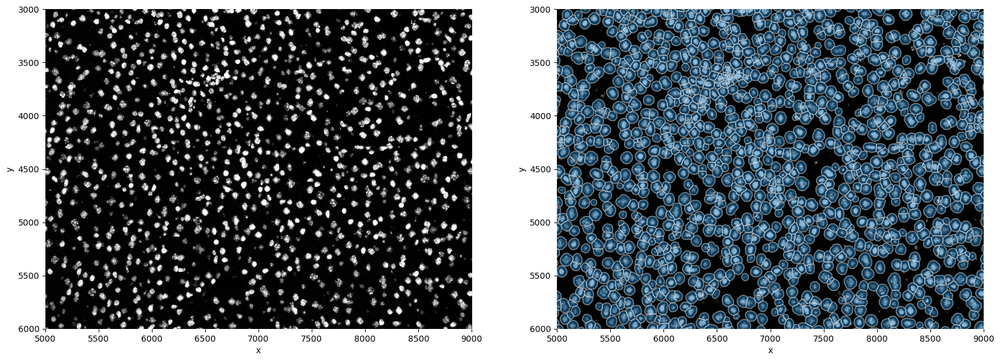

In [12]:
fc.segmentationPlot( sdata=sdata, crd=crd, shapes_layer='expanded_cells20' )

# Creating the anndata object and allocating the transcripts 

In this steps multiple things happen:
- Shapes of the different cels in the mask are extracted and saved as a geopandas object. 
- The transcript file is read in  and all transcripts lying in the nuclei/cells are assigend to those nuclei/cells. I should find a new way to add my quality control here. All trancripts outside of the nuclei can't be assigned surely to a cell and are thus discarded. Doing differently created very messy cells. 
- Only cells with transcripts are retained, and the shapes of the cells are added to the anndata in adata.obsm['polygons']


In [18]:
transformed_ddf=fc.apply_transform_matrix(
    path_count_matrix=path_coordinates,
    output_path=os.path.join( OUTPUT_DIR, 'detected_transcripts_transformed.parquet' ),
    delimiter='\t',
 )

sdata,ddf=fc.create_adata_from_masks_dask( 
    path=os.path.join( OUTPUT_DIR, 'detected_transcripts_transformed.parquet' ),
    sdata=sdata,
    shapes_layer='nucleus_boundaries'
  )
## TO DO : add verbose options

No transform matrix given, will use identity matrix.
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]]
creating masks from polygons
Created masks with shape (12864, 10720)
Calculate cell counts
Create anndata object


In [14]:
# some sanity checks
sdata.table[ '13', 'Ghr' ].to_df()

gene,Ghr
cells,
13,8


plot transcripts matrix for cell 1333 and gene Ghr
Plotting 75 transcripts.
Selecting boundaries
Plotting boundaries
End plotting boundaries


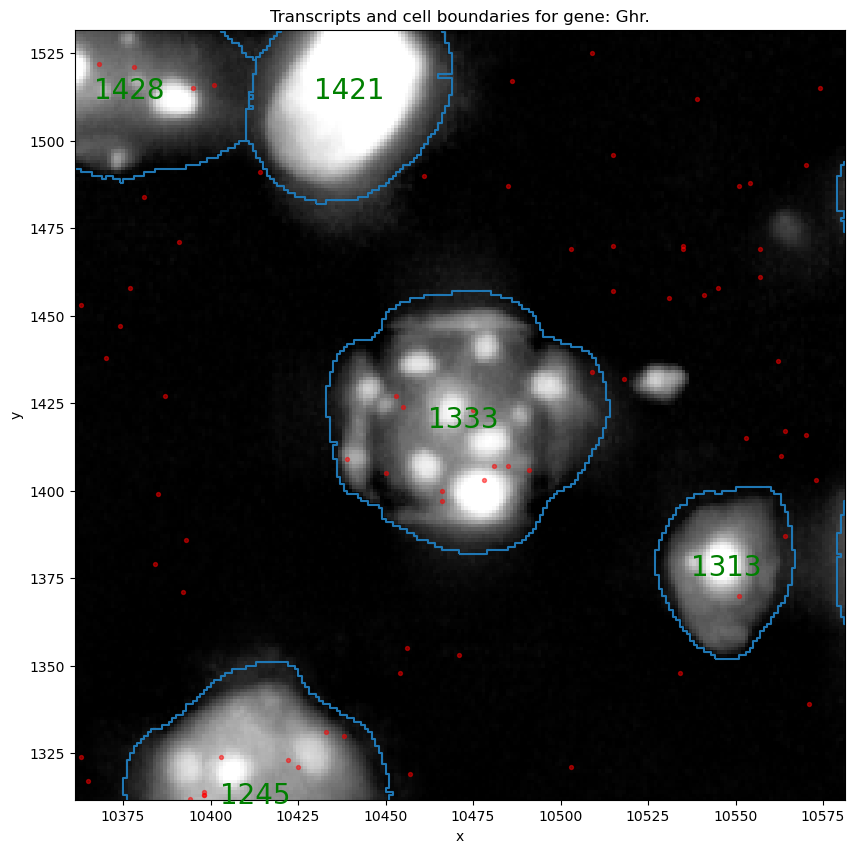

In [51]:
random_cell='1333'
random_gene='Ghr'

diameter=60

if random_cell is not None and random_gene is not None:

    cell_center= sdata.table.obsm[ 'spatial' ][ sdata.table.to_df().index.get_loc( str(random_cell) ) ]
    crd=[ cell_center[0] - (diameter +50 ),  
            cell_center[0] + (diameter +50 ),   
            cell_center[1] - (diameter +50 ), 
            cell_center[1] + (diameter +50 ) ]

    print( f"plot transcripts matrix for cell {random_cell} and gene {random_gene}" )

    fc.sanity_plot_transcripts_matrix( 
        xarray=ic[ 'corrected' ], 
        in_df=ddf,
        crd=crd,
        polygons=sdata[ 'nucleus_boundaries' ],
        plot_cell_number=True, 
        gene=random_gene,
        )

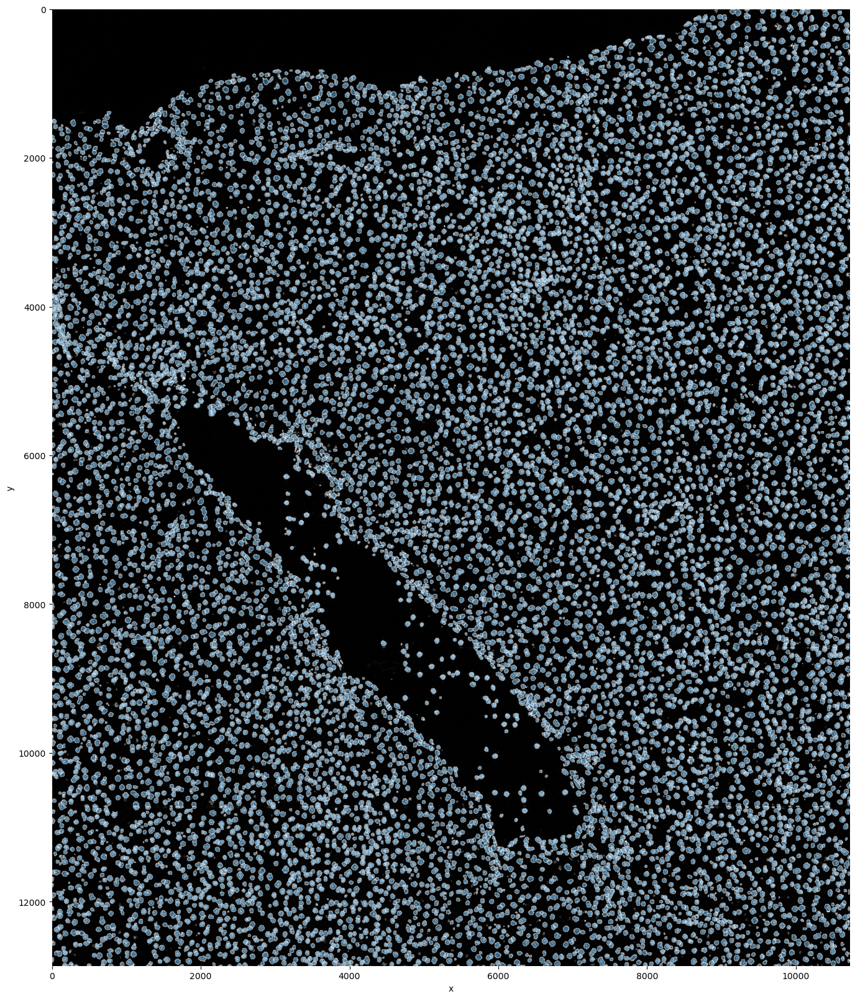

In [16]:
fc.plot_shapes(sdata,shapes_layer='nucleus_boundaries')

After we have created the anndaa object, we control the transcript quality. 

First we create a plot to chekc if the transcript density is similar across the whole tissue.
Depending on the panel choice, it is possible it depends on the region. This can also be checked here. 

Secondly, we will have a look at how many transcripts per gene we actually are using. This will be very gene-dependent, as some genes are marker genes for bigger cells than other genes, and thus have more cytoplasm with transcripts. 

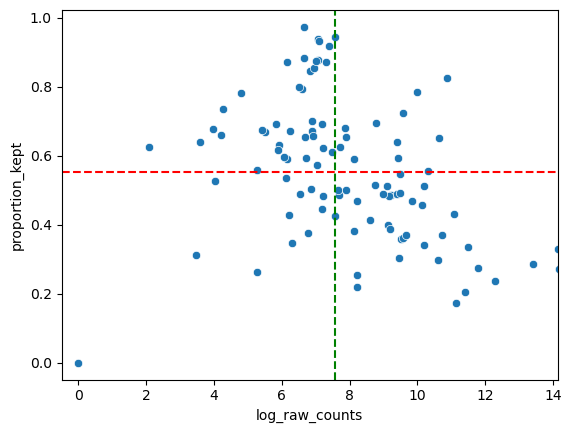

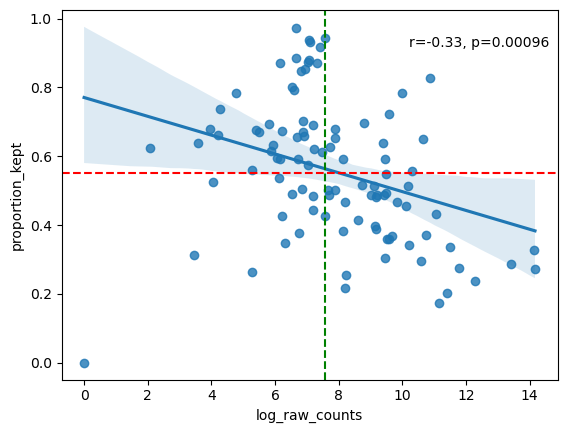

The ten genes with the highest proportion of transcripts filtered out
          proportion_kept  raw_counts
gene                                 
Ms4a7            0.000000           1
Gls2             0.172883       69035
Glul             0.204057       89823
Atp6v0d2         0.218741        3671
Ghr              0.237562      215502
Des              0.255187        3711
Folr2            0.262887         194
Cyp2e1           0.273348     1421904
Hal              0.274376      130806
Fn1              0.287315      677966


In [20]:
filtered=fc.analyse_genes_left_out(sdata,ddf.compute())

In [65]:
#sdata.write( os.path.join(  OUTPUT_DIR, 'sdata_allocation.zarr' ) )

In [ ]:
#from spatialdata import read_zarr
#sdata_load=read_zarr( os.path.join(  OUTPUT_DIR, 'sdata_allocation.zarr' ) )

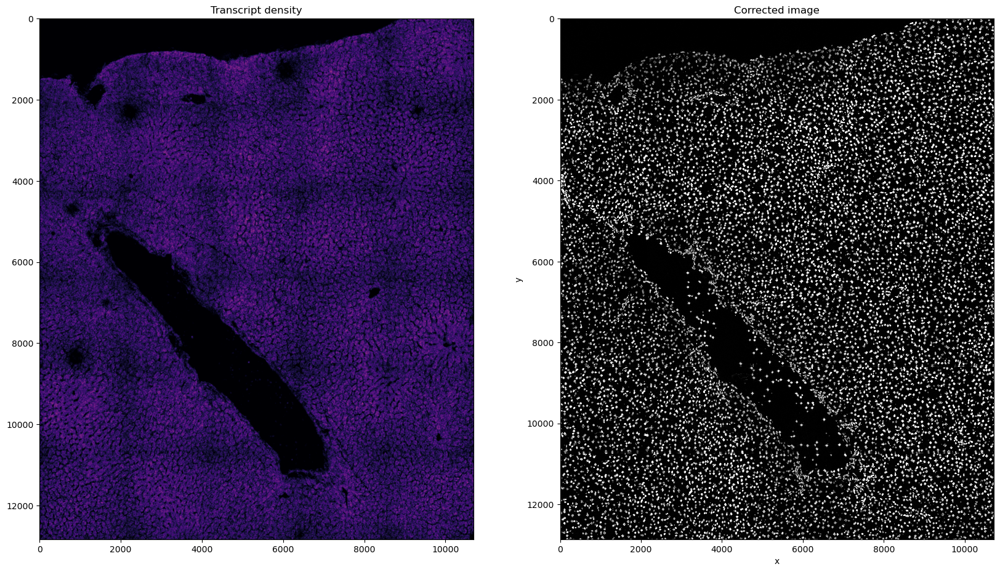

In [21]:
# TODO: this will not scale well for vizgen, also need to add support for crops
blurred=fc.control_transcripts(ddf.compute()) #do we ad this image to the sdata object? 
fc.plot_control_transcripts(blurred,sdata)

Plot shapes is a function that can be used to visualize the cells (and subsets) on the image. By defining the column, the cells can be colored, as we will see later. Alpha defines the see-throughness to the plotted masks.  

# Preprocess adata 

This next code  preprocesses the adata object. 
- calculate QC metrics
- filter cells with less then 10 gene counts and genes with less then 5 cells (adaptations possible by adapting the function)
- Nuc_Size_norm: standard: perform normalization based on the size of the cell/nucleus, followed by scaling. If put to False, normal library size normalazation is performed (not recomendable, but you can check the difference).

The last plot shows the size of the nucleus related to the counts. When working with whole cells, if there are some really big xcells with really low counts, they are probably not real cells and you should filter based on max size. 

In [26]:
sdata.table.raw 


In [20]:
sdata.table.to_df().sum()

gene
Acta2       4521
Adamtsl2    1717
Adgre1      1986
Adgrg6       832
Atp6v0d2     749
            ... 
Vwf         4498
Wnt2         823
Wnt9b        253
Wt1          146
Xcr1         212
Length: 100, dtype: int64

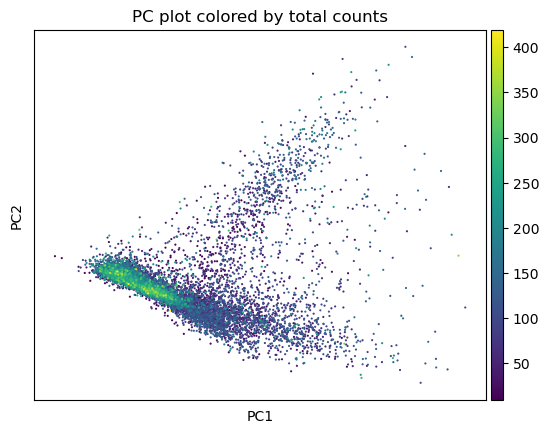

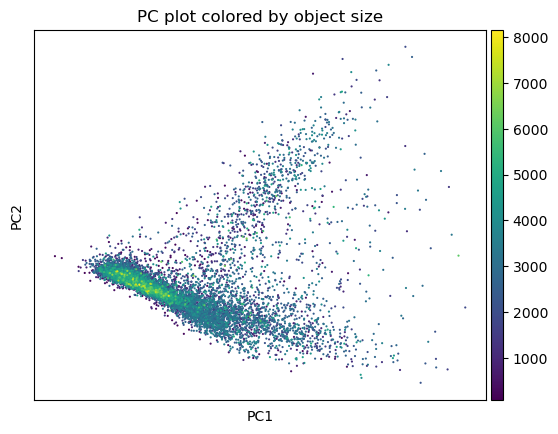

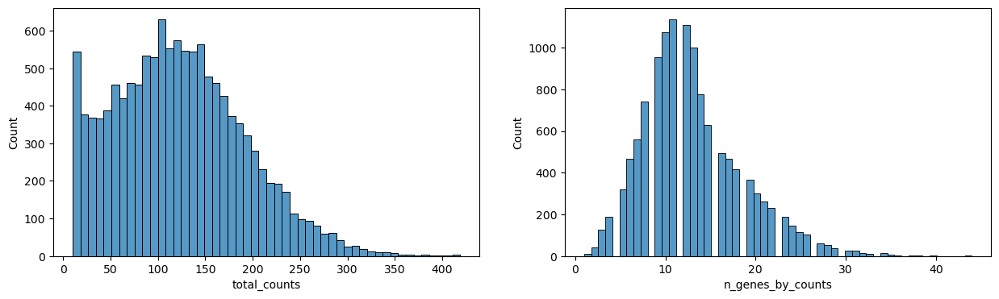

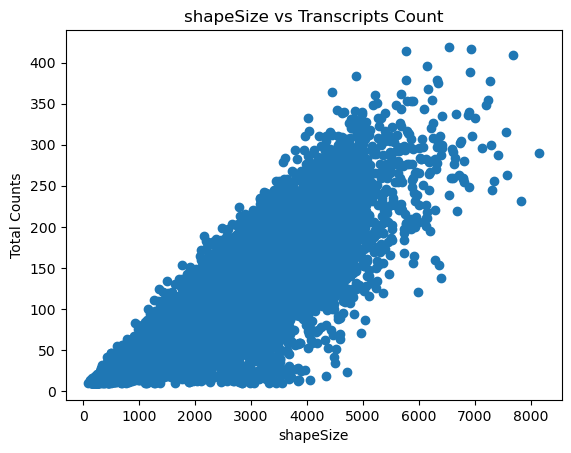

In [24]:
sdata = fc.preprocessAdata(
    sdata=sdata, 
    nuc_size_norm=True,
    shapes_layer='nucleus_boundaries',
    )  
fc.preprocesAdataPlot(sdata , ) 

In [27]:
sdata.table.raw.to_adata().to_df()

gene,Acta2,Adamtsl2,Adgre1,Adgrg6,Atp6v0d2,Axl,C5ar1,Ccr2,Ccr7,Cd14,...,Timd4,Tmem119,Trem2,Upk3b,Vsig4,Vwf,Wnt2,Wnt9b,Wt1,Xcr1
cells,,,,,,,,,,,,,,,,,,,,,
4,0.0,0.031175,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.031175,0.0,0.0,0.000000,0.0,0.000000,0.0,0.146978,0.0
5,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0
6,0.0,0.000000,0.028322,0.0,0.028322,0.134213,0.028322,0.0,0.0,0.0,...,0.028322,0.000000,0.0,0.0,0.028322,0.0,0.000000,0.0,0.000000,0.0
7,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.038645,0.0,0.000000,0.0
9,0.0,0.000000,0.000000,0.0,0.025178,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24356,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0
24363,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,...,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0
24373,0.0,0.000000,0.000000,0.0,0.000000,0.111288,0.000000,0.0,0.0,0.0,...,0.057191,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0


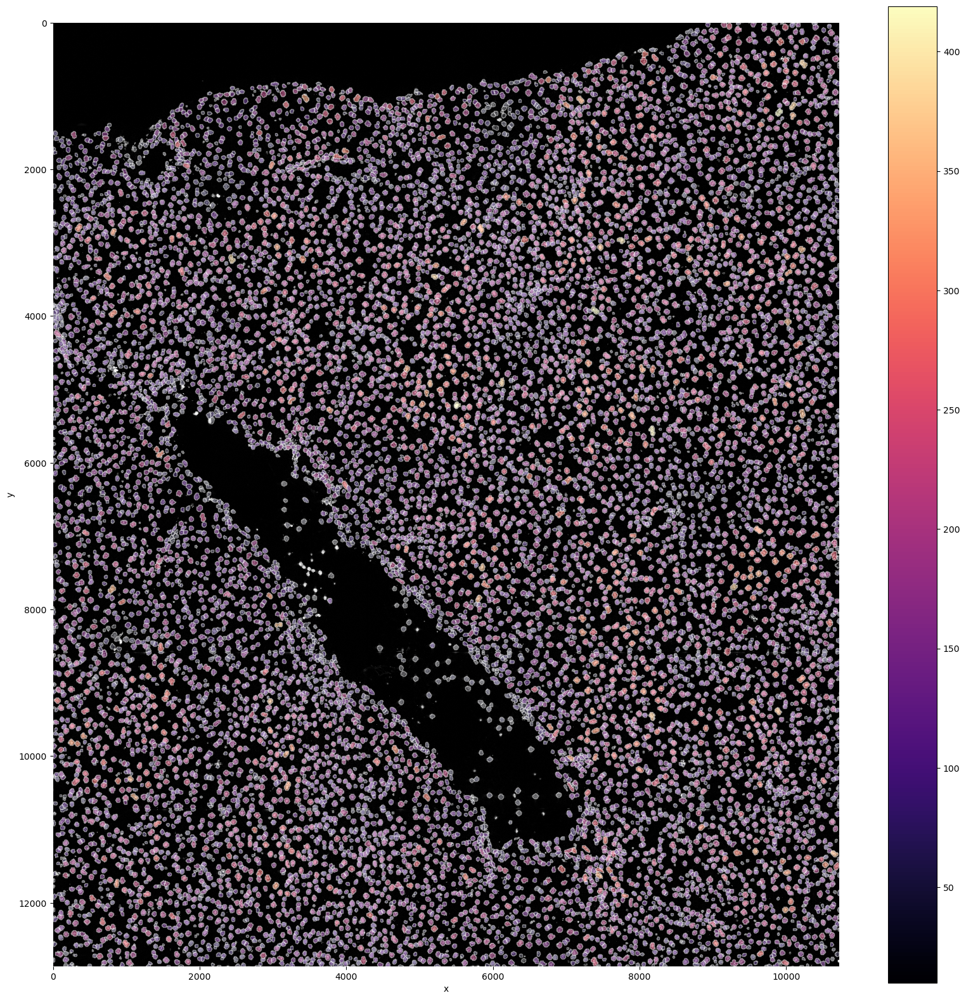

In [32]:
fc.plot_shapes(sdata, column="total_counts")

In this step you can filter cells based on their size: are you sure cells need to be bigger, or sure your cells can not be larger than X? 

You can delete them with this function by defining min_size and max_size. 

If necessary, this function includes an extra filter step based on the estimated locations of the cells. The center of the cell is calculated as the mean location of the transcripts allocated to the cell, and as the middle of the shape.
If the distance between both is really large, possibly the shape contains more than only the cell, and the cell is deleted. This isn't used for nucleus segmentation. 

450 cells were filtered out based on size.


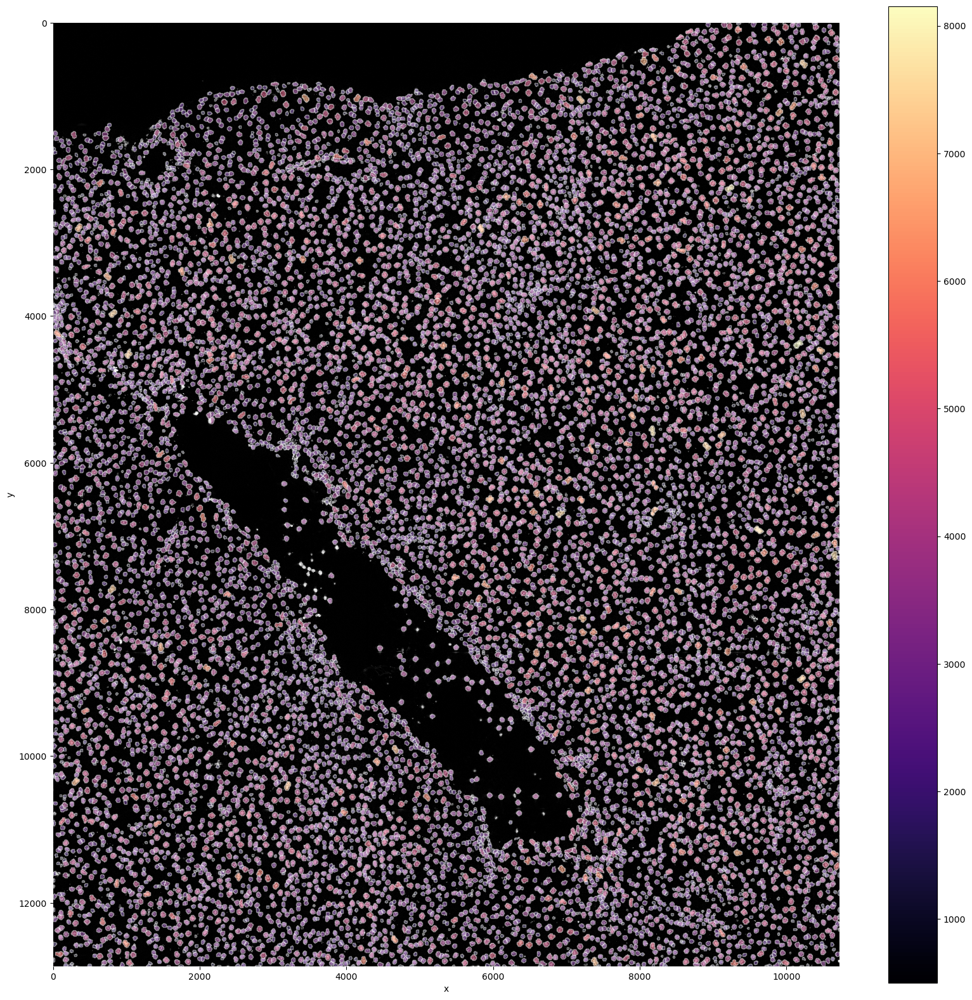

In [33]:
sdata = fc.filter_on_size(sdata, min_size=500)
fc.plot_shapes(sdata, column="shapeSize")

This function performs the neighborhood analysis and the leiden clustering and the UMAP (standard scRNA stuff).

You need to define 2 parameters:
- the amount of PC's used: I normally choose something between 15-20 based on the plot.
- The amount of neighbors used: Normally I go for 35. Less neighbors means more spread, more means everything tighter. (I think?)

It returns the UMAP and marker gene list per cluster, that can be looked at for finding celltypes. 

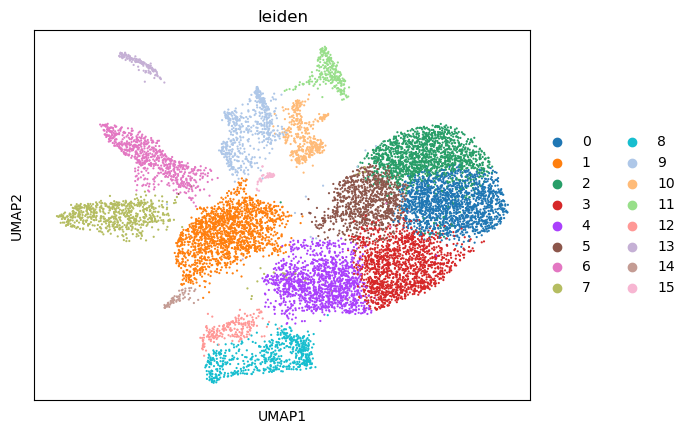

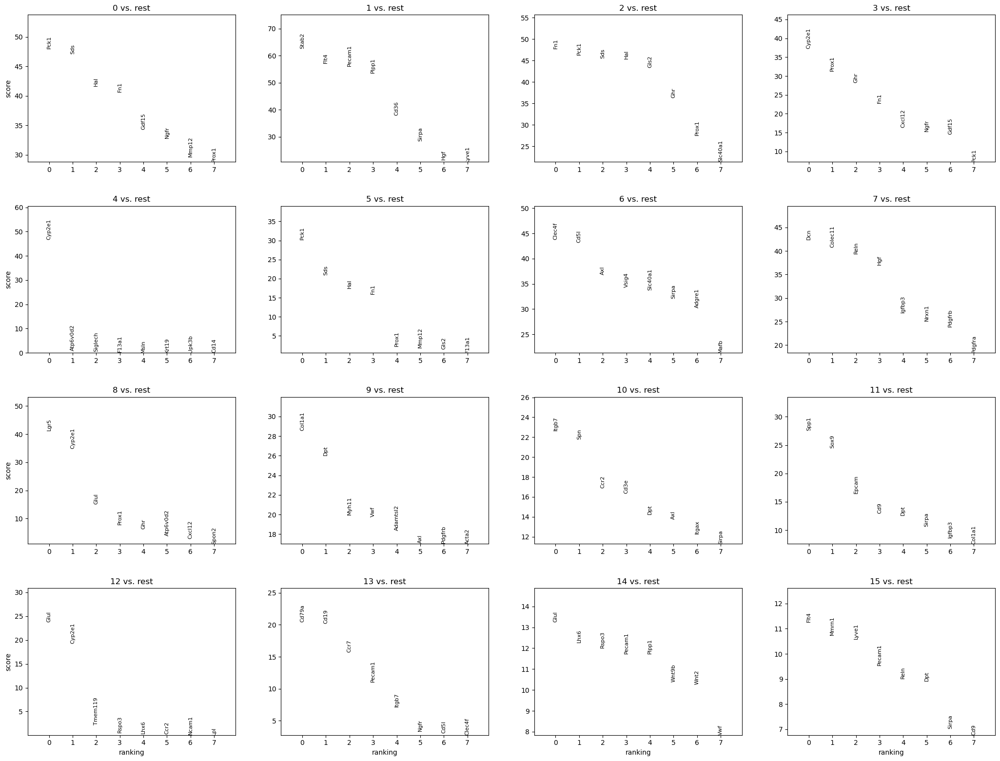

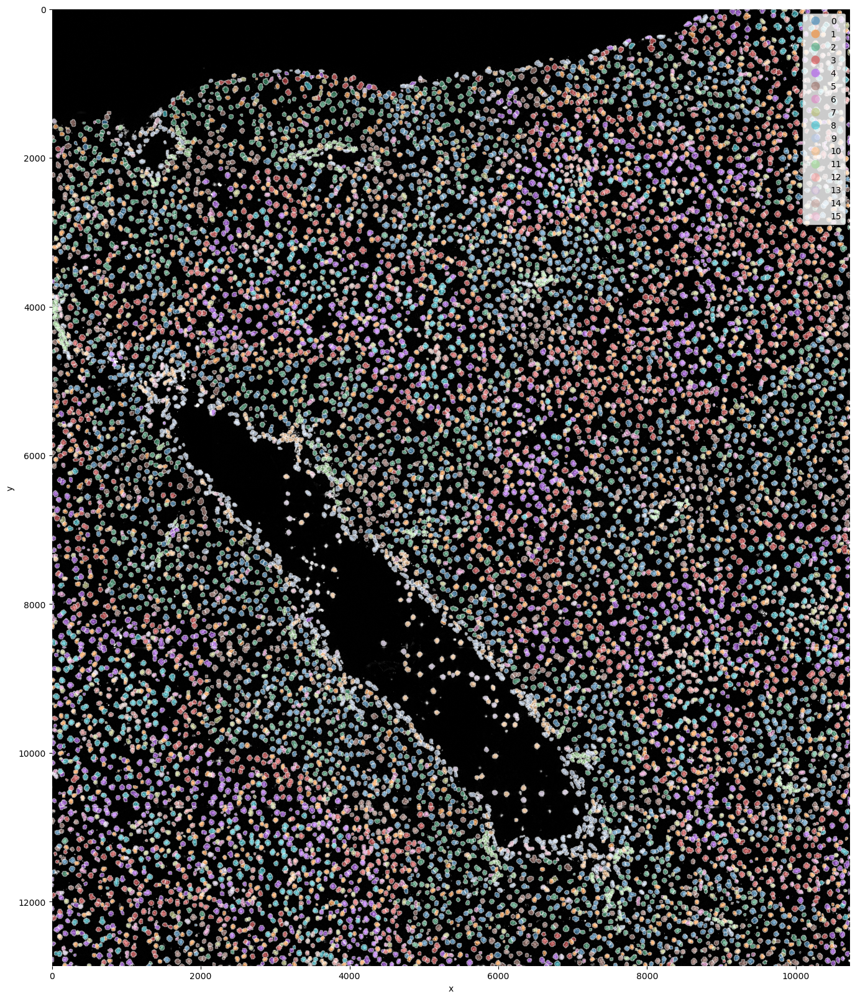

In [34]:
sdata = fc.clustering(sdata, 17, 35)
fc.clustering_plot(sdata)
fc.plot_shapes(sdata, column="leiden")

Here we reuse the plot_shapes function to actually plot a subfigure of our image with the cells colored based on the clustering.

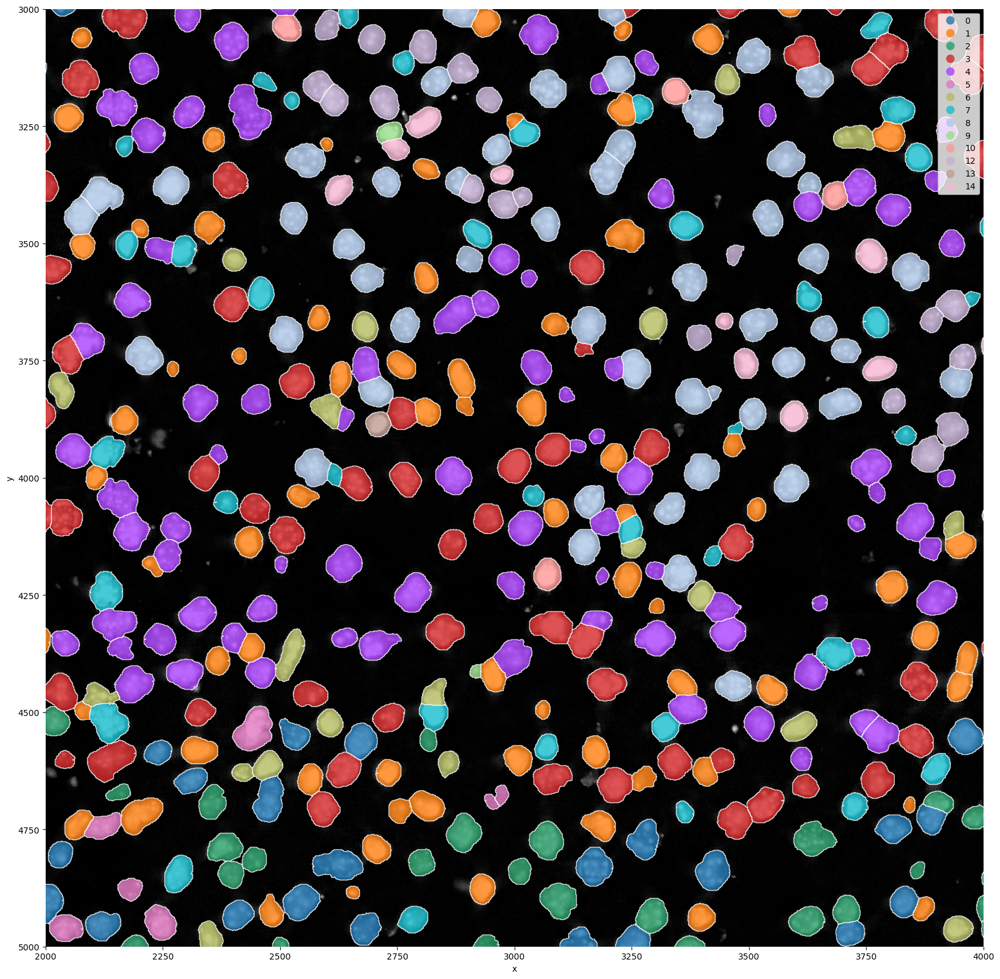

In [35]:
crd = [2000, 4000, 3000, 5000]
if SMALL_IMAGE:
    crd = [2000, 4000, 3000, 4000]

fc.plot_shapes(
    sdata, 
    column="leiden", 
    crd=crd, 
    alpha=0.8, 
    shapes_layer='nucleus_boundaries' 
    )

# Annotating the cells 

In this part of the code we are going to annotate the cells based on the marker geneslist. 
The marker geneslist should be a csv with the genes  in the rows and the celltypes in the columns.
If a certain gene is a marker for a certain celltype, the value of the cell should be 1, otherwise it should be zero. 
This matrix is then used to annotate cells.  The path of the marker geneslist csv file is the input for the function.

All cells are scored for all celltypes. The higher the score the more likely a cell is belonging to a celltype. 

Sometimes some celltypes give way higher scores then others. This is the case in liver for hepatocytes. When you then want readable heatmaps, put the RowNorm=True.
This normalizes the scores within each cell. 
This will not influence which celltype a cell will get, but will influence the plots. 
However, for some downstream adaptations, you will not want this normalization. 

If not working with liver, you should use the pl.score_genes.

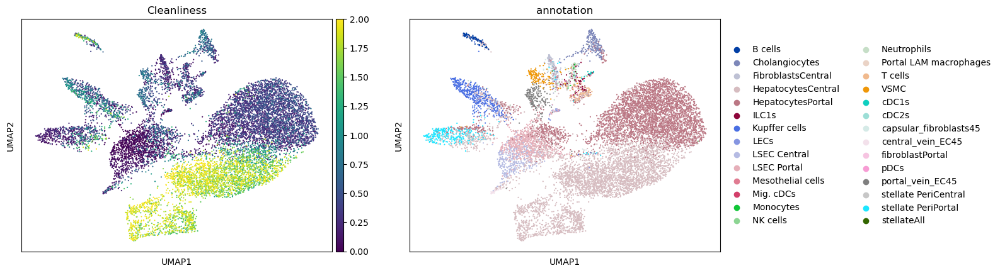

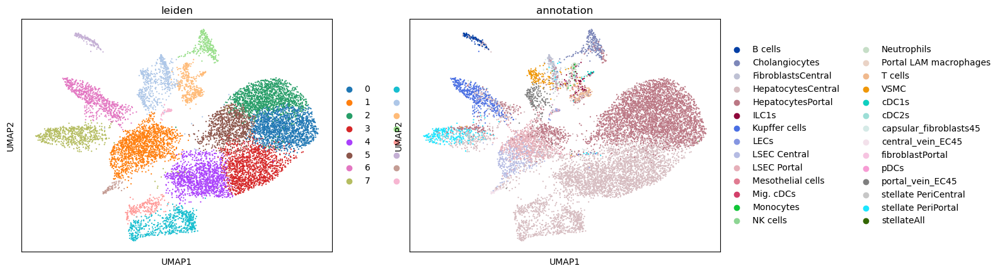

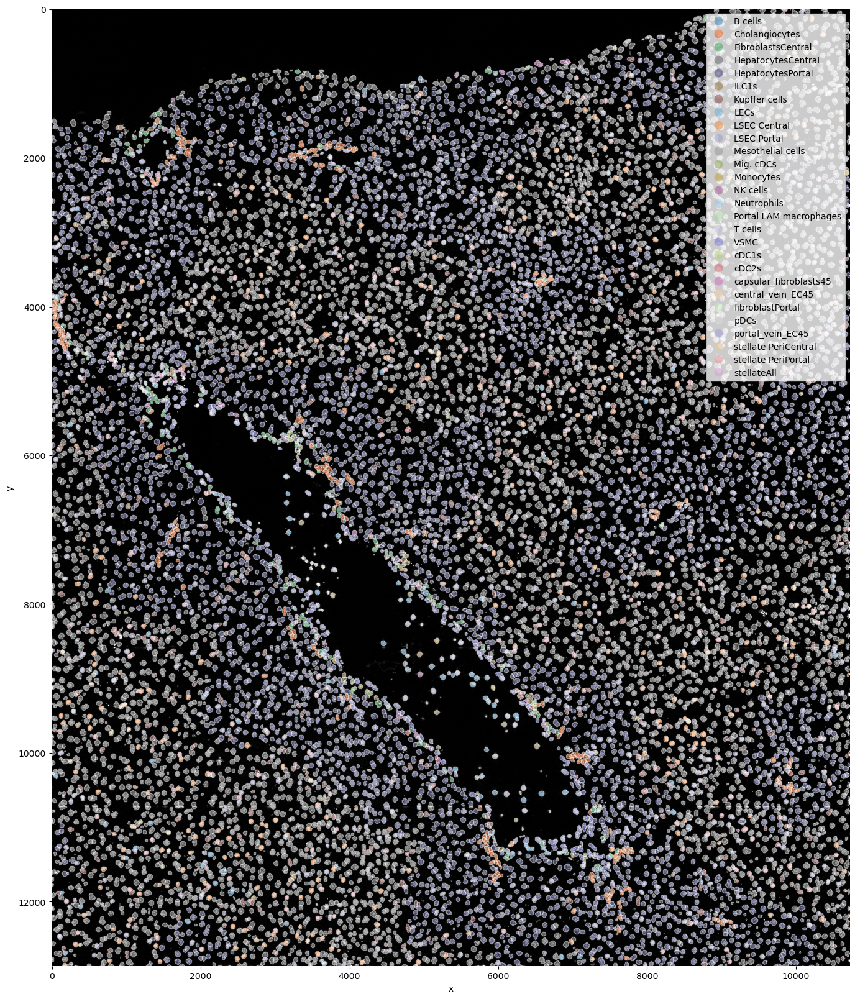

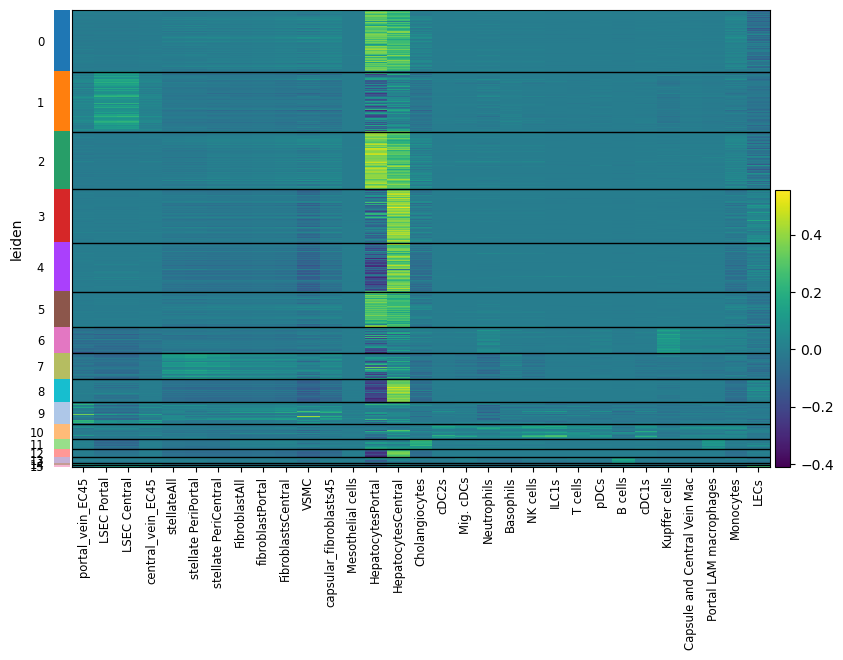

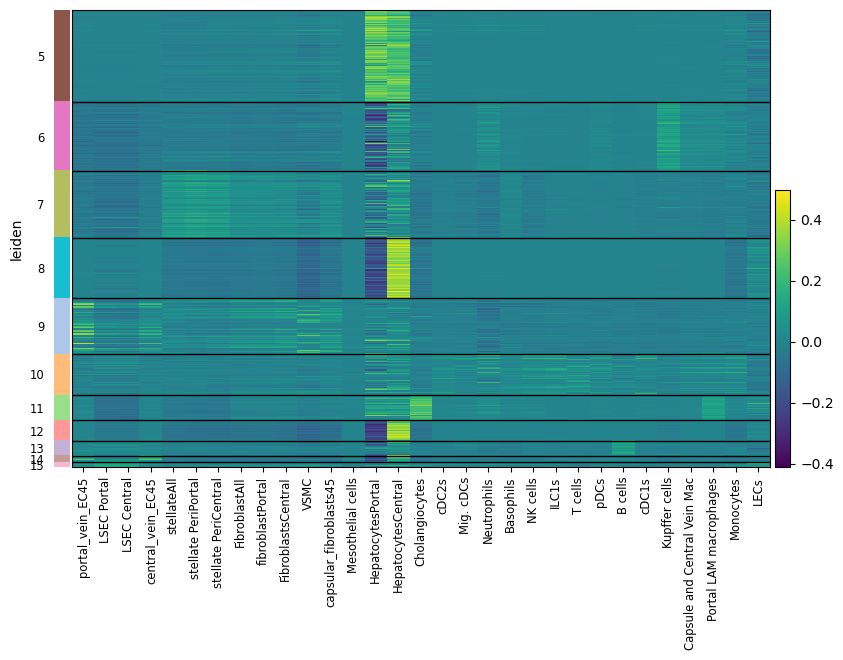

In [36]:
path_mg = DATA_PATH_PREFIX + "/resolve_liver/markerGeneListMartinNoLow.csv"

mg_dict, scoresper_cluster = fc.scoreGenes(
    sdata=sdata,
    path_marker_genes=path_mg, 
    repl_columns={"Tot_Score_": "", "uppfer": "upffer"}, 
    del_celltypes=["Hepatocytes", "LSEC45"])

fc.scoreGenesPlot(
    sdata=sdata, 
    scoresper_cluster=scoresper_cluster, 
    filter_index=5)

In liver, the marker genes for hepatocytes are everywhere, but way higher expressed in hepatocytes. This result in a high score for hepatocytes in cells that aren't hepatocytes. 

But those cells score much lower on being hepatocyte then the hepatocytes itselves. So they clearly aren't hepatocytes. 
In the following code we try to estimate how high of a hepatocyte score we actually need to assign a cell hepatocyte. 
In this case it is only necessary for hepatocytes. For melanoma more were necessary. 

We tried other techniques for annotation, such as Tangram too, but they seem to work even less good.
So this is the best we have at the moment. 

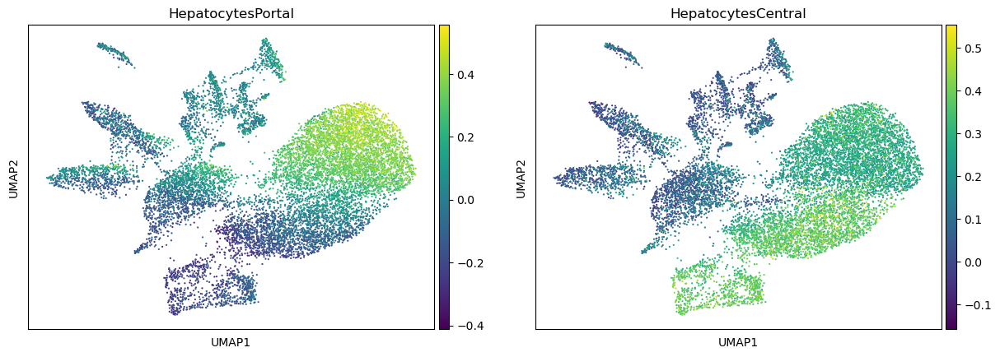

In [37]:
sc.pl.umap(sdata.table, color=["HepatocytesPortal",'HepatocytesCentral'])

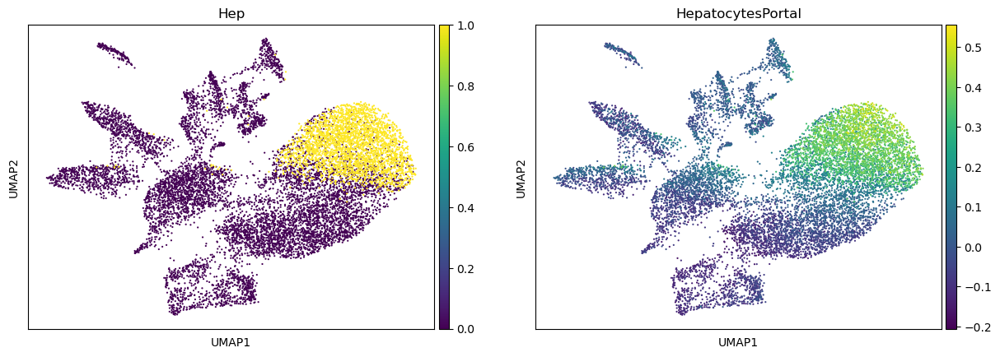

In [52]:
sdata.table.obs["Hep"] = (sdata.table.obs["HepatocytesPortal"]>0.28).astype(int)
sc.pl.umap(sdata.table, color=["Hep","HepatocytesPortal"])

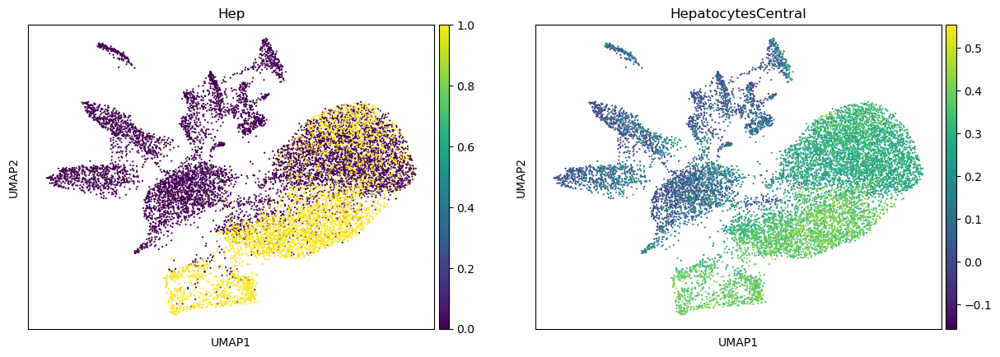

In [43]:
sdata.table.obs["Hep"] = (sdata.table.obs["HepatocytesCentral"]>0.3).astype(int)
sc.pl.umap(sdata.table, color=["Hep","HepatocytesCentral"])

In [53]:
correct_marker_genes=True

if correct_marker_genes:
    sdata = fc.correct_marker_genes(
        sdata=sdata,
        celltype_correction_dict={"HepatocytesPortal": (0.3, 2.0),'HepatocytesCentral':(0.28,2.0)}) #fix here to hepatocytes portal and central! 

This code checks how well the clusters agree with the celltyping, it looks at every cluster and which celltypes are in there. You would want clean columns: one color per column.

When not working with liver, put liver==False

As not al celltypes can be distinguished based on 100 genes, I w-in liver mode combine celltypes. But a better idea would be to adapt the marker genes lists and only include the celltypes you are interested in. 
You can adapt this for your data too. 

Colors can also be adapted per cluster, but this is not an option yet, you would have to adapt the functions for that. 

Beautiful output plots. 

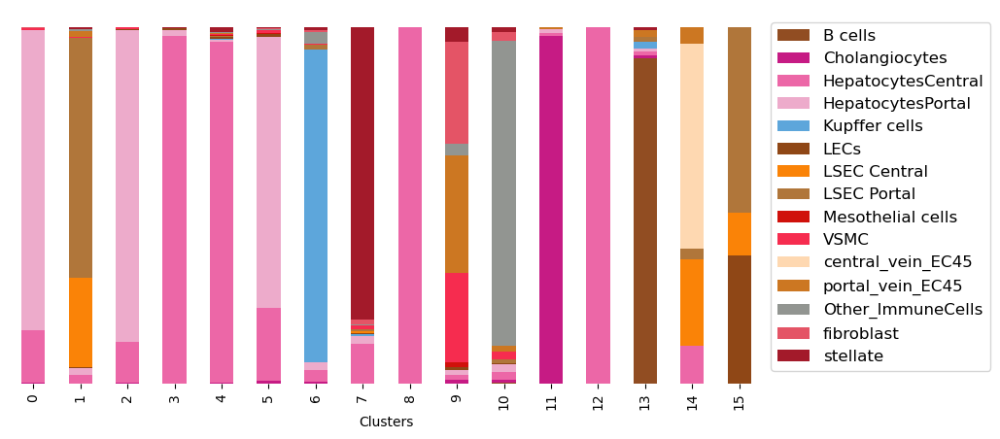

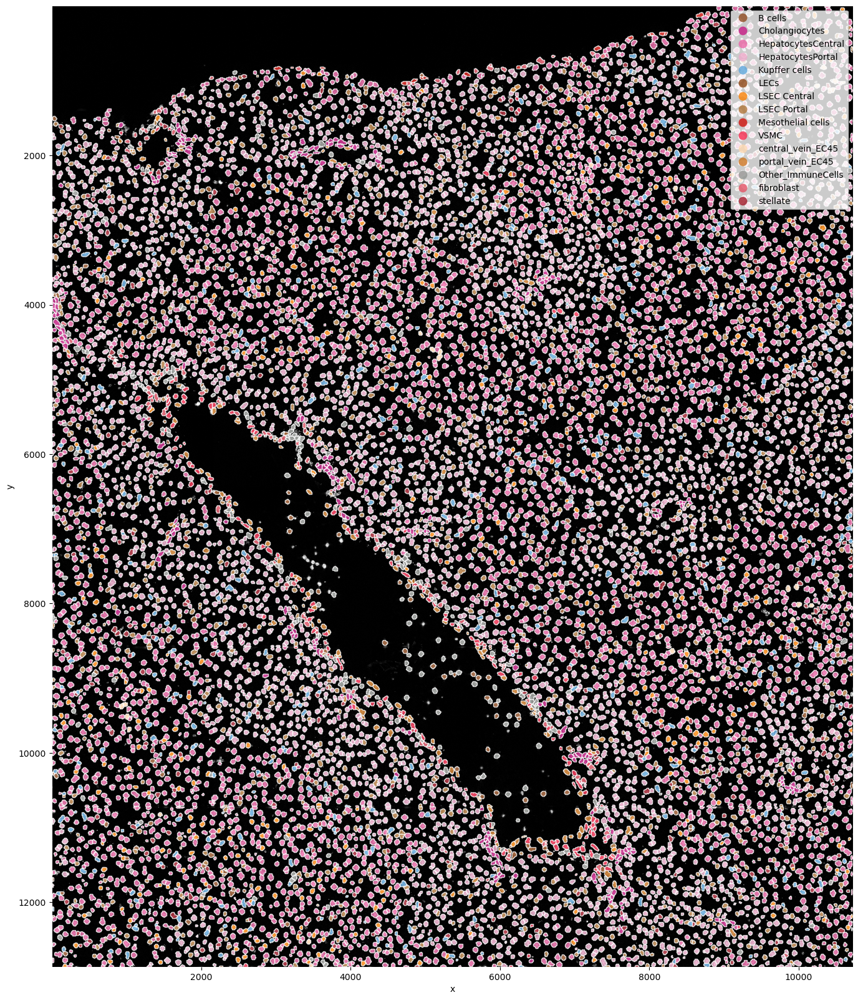

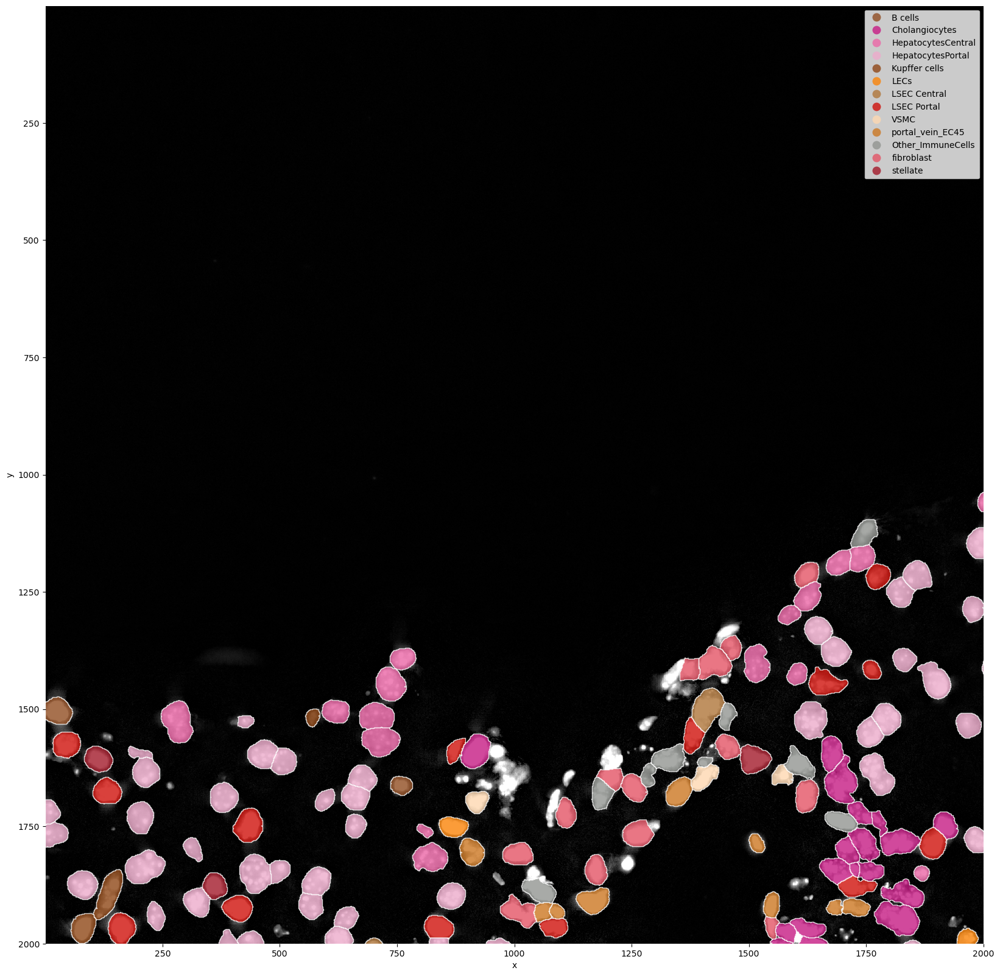

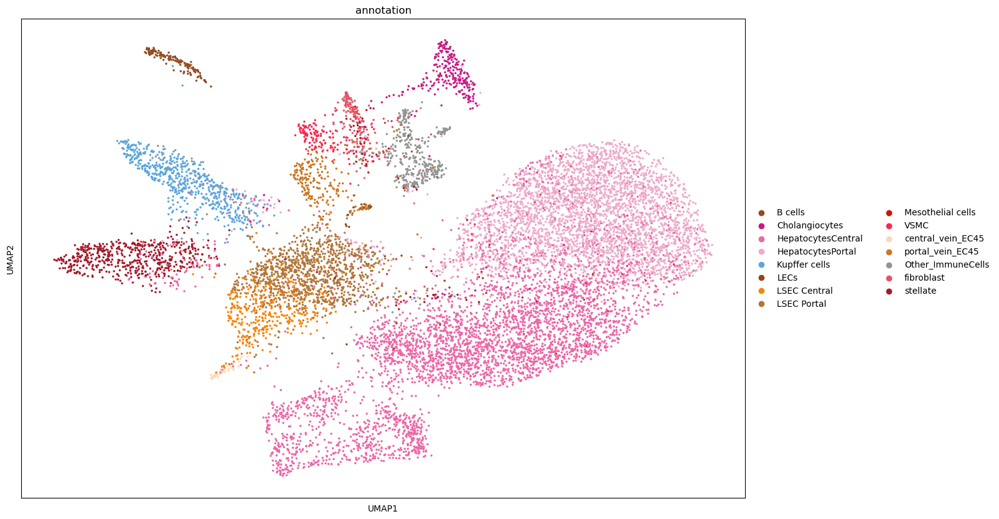

In [54]:
colors = ['#914d22','#c61b84','#ec67a7','#edabcb','#5da6db','#8f4716','#fa8307','#b0763a','#d0110b','#f62c4f','#fed8b1','#cc7722','#929591','#E45466','#a31a2a']
gene_indexes = {"Other_ImmuneCells": [1,2,8,14,15,16,17,18,19,21,22,26], "fibroblast": [4,5,23,25], "stellate": [28,29,30]}

sdata, color_dict = fc.clustercleanliness(
    sdata=sdata, 
    genes=list(mg_dict.keys()), 
    gene_indexes=gene_indexes,
    colors=colors,
    )

fc.clustercleanlinessPlot(
    sdata, 
    color_dict=color_dict, 
    crd=[ 0, 2000, 0, 2000 ],
    )

This code checks how well the clusters agree with the celltyping, it looks at every cluster and which celltypes are in there. You would want clean columns: one color per column.

When not working with liver, put liver==False

As not al celltypes can be distinguished based on 100 genes, I w-in liver mode combine celltypes. But a better idea would be to adapt the marker genes lists and only include the celltypes you are interested in. 
You can adapt this for your data too. 

Colors can also be adapted per cluster, but this is not an option yet, you would have to adapt the functions for that. 

Beautiful output plots. 

Some adaptations to save the data.

In [55]:
sdata = fc.enrichment(sdata) 

  0%|          | 0/1000 [00:00<?, ?/s]

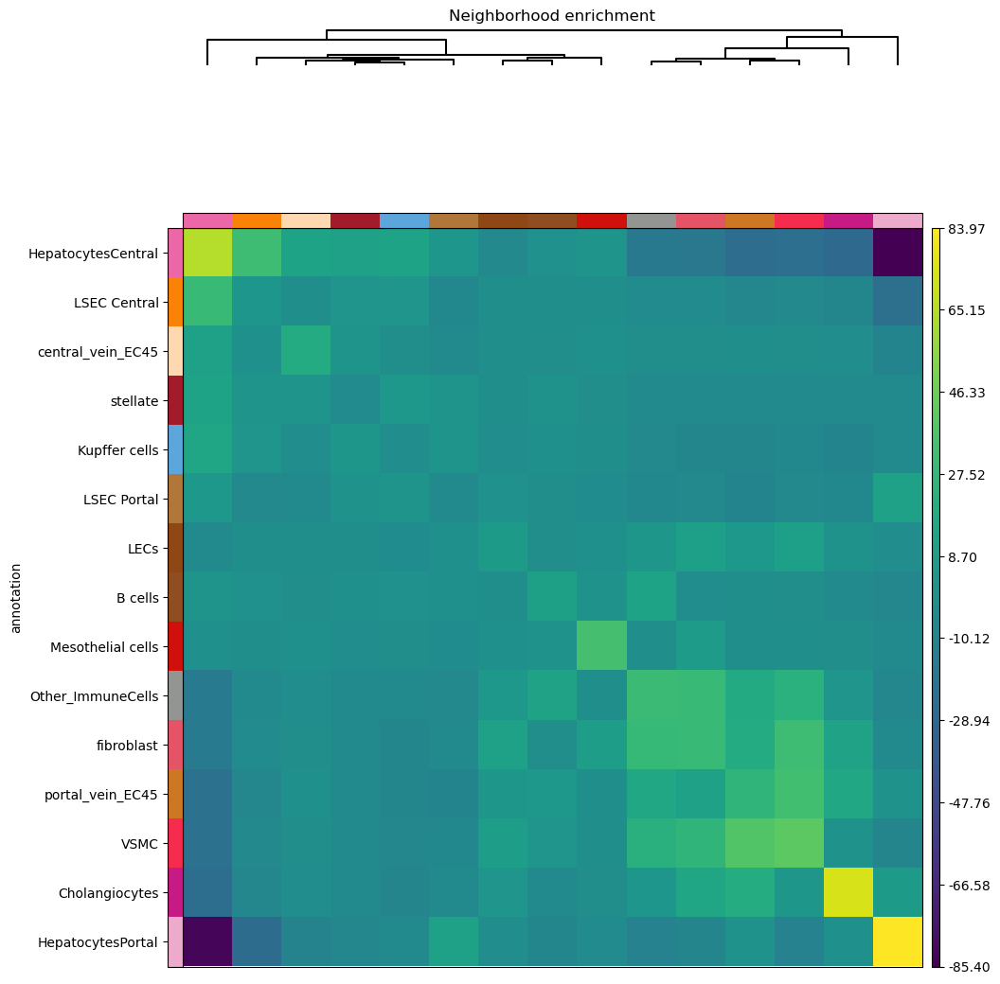

In [56]:
fc.enrichment_plot(sdata)

Use squidpy to see the enrichement between the different celltypes.
For more info, see squidpy!

In [57]:
sdata.table.obs

,region,instance,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_2_genes,pct_counts_in_top_5_genes,n_counts,shapeSize,...,cDC1s,Kupffer cells,Capsule and Central Vein Mac,Portal LAM macrophages,Monocytes,LECs,Cleanliness,annotation,Hep,annotationSave
cells,,,,,,,,,,,,,,,,,,,,,
4,1,1,17,2.890372,53,3.988984,50.943396,73.584906,53,3158.0,...,-0.001641,-0.013932,-0.011231,-0.015881,-0.027308,-0.029649,0.047196,Mesothelial cells,0,Mesothelial cells
5,1,1,9,2.302585,105,4.663439,78.095238,95.238095,105,2605.0,...,0.000000,-0.006818,-0.005158,-0.005641,-0.030791,0.006506,1.817512,HepatocytesCentral,0,HepatocytesCentral
6,1,1,27,3.332205,133,4.897840,65.413534,78.195489,133,3481.0,...,-0.004472,0.052999,0.029344,0.026756,-0.012763,0.013901,0.057821,Other_ImmuneCells,0,Neutrophils
7,1,1,13,2.639057,46,3.850148,50.000000,73.913043,46,2538.0,...,-0.006026,-0.011254,-0.001618,-0.005409,-0.013741,-0.018621,0.079265,LSEC Central,0,LSEC Central
9,1,1,7,2.079442,213,5.365976,89.201878,99.061033,213,3922.0,...,0.002798,0.000000,0.001217,0.001311,-0.053062,0.024868,1.732252,HepatocytesCentral,0,HepatocytesCentral
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24356,1,1,12,2.564949,174,5.164786,73.563218,91.379310,174,2928.0,...,0.014228,-0.001049,0.007931,0.008572,0.036928,-0.035071,0.343728,HepatocytesPortal,1,HepatocytesPortal
24363,1,1,13,2.639057,90,4.510860,45.555556,76.666667,90,2919.0,...,-0.003488,0.031273,0.000698,-0.004205,-0.002235,-0.011045,0.245465,HepatocytesCentral,0,HepatocytesCentral
24373,1,1,13,2.639057,37,3.637586,67.567568,78.378378,37,1699.0,...,-0.003010,0.079759,0.014091,0.013444,0.002118,0.028596,0.944374,Kupffer cells,0,Kupffer cells


In [50]:
sdata.write( os.path.join(  OUTPUT_DIR, 'sdata.zarr'  ) )

In [47]:
#from spatialdata import read_zarr
#sdata_load=read_zarr( os.path.join(  OUTPUT_DIR, 'sdata.zarr'  ) )